# Testing frame confirmation latency

In [1]:
using JSON, DataFrames, StatsPlots, StatsBase

In [2]:
function extract_frame_confirmation_timings(file_path)
    frame_confirmation_timings = []
    open(file_path) do f
        for (i, l) in enumerate(eachline(f))
            if occursin("Waiting for the frame confirmation took:", l)
                push!(frame_confirmation_timings, parse(Float64,match(r"\d*\.\d* ms", l).match[begin:(end-3)]))
            end
        end
    end
    return DataFrame(time = frame_confirmation_timings)
end

extract_frame_confirmation_timings (generic function with 1 method)

No saving with Y16 1920x1200 image format

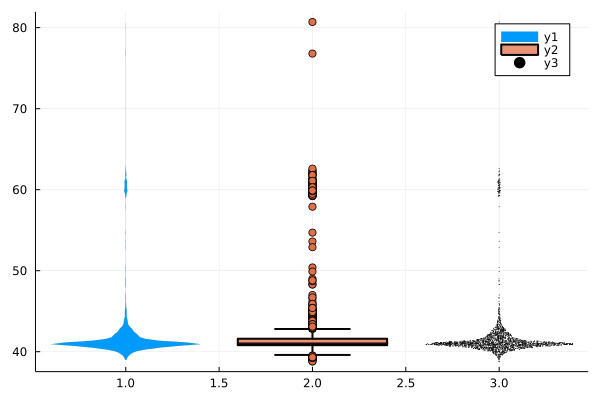

In [3]:
timings_no_saving = extract_frame_confirmation_timings("2_camera_2LS_with_stage_no_saving_2022_09_20_15_50.log")
@df timings_no_saving violin(:time, linewidth=0)
@df timings_no_saving boxplot!(:time, fillalpha=0.75, linewidth=2)
@df timings_no_saving dotplot!(:time, marker=(:black, stroke(0)), markersize = 0.5)

In [4]:
describe(timings_no_saving, :all, cols=:time)

,variable,mean,std,min,q25,median,q75,max,nunique
,Symbol,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Int64
1,time,41.897,3.74135,38.8,40.8,41.0,41.6,80.7,150


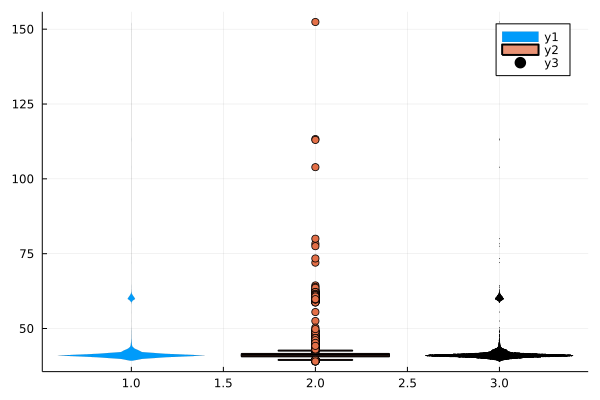

In [57]:
timings_no_saving = extract_frame_confirmation_timings("2_camera_2LS_with_stage_waiting_no_saving_Y16_2022_09_21_13_49.log")
@df timings_no_saving violin(:time, linewidth=0)
@df timings_no_saving boxplot!(:time, fillalpha=0.75, linewidth=2)
@df timings_no_saving dotplot!(:time, marker=(:black, stroke(0)), markersize = 0.5)

In [58]:
describe(timings_no_saving, :all, cols=:time)

,variable,mean,std,min,q25,median,q75,max,nunique
,Symbol,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Int64
1,time,42.1988,4.60198,39.0,40.7,41.1,41.5,152.4,227


No saving with RGB24 1920x1200 image format

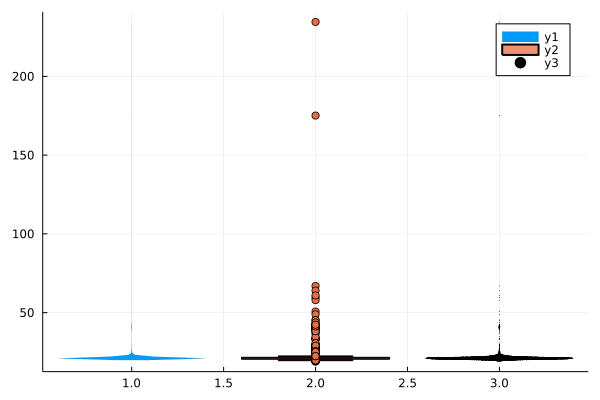

In [59]:
timings_no_saving = extract_frame_confirmation_timings("2_camera_2LS_with_stage_no_saving_RGB24_2022_09_21_13_17.log")
@df timings_no_saving violin(:time, linewidth=0)
@df timings_no_saving boxplot!(:time, fillalpha=0.75, linewidth=2)
@df timings_no_saving dotplot!(:time, marker=(:black, stroke(0)), markersize = 0.5)

In [60]:
describe(timings_no_saving, :all, cols=:time)

,variable,mean,std,min,q25,median,q75,max,nunique
,Symbol,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Int64
1,time,21.2745,2.8492,19.0,20.7,21.0,21.3,234.5,197


Async saving with this implementation:
```
        private async void saveBufferAsTiff(IFrameQueueBuffer buffer, String savePath)
        {
            await Task.Run(() =>
            {
                buffer.SaveAsTiff(savePath);
                Debug.WriteLine($"Saved IFrameQueueBuffer to tiff asyncronously to path: {savePath}. Buffer data size: {buffer.ActualDataSize}");
                queueSink.QueueBuffer(buffer);
            });
        }
```

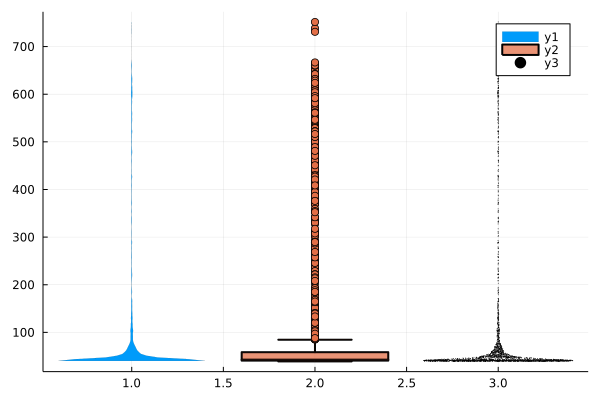

In [61]:
timings_with_saving_async = extract_frame_confirmation_timings("2_camera_2LS_with_stage_waiting_saving_async_2022_09_20_15_58.log")
@df timings_with_saving_async violin(:time, linewidth=0)
@df timings_with_saving_async boxplot!(:time, fillalpha=0.75, linewidth=2)
@df timings_with_saving_async dotplot!(:time, marker=(:black, stroke(0)), markersize = 0.5)

In [62]:
describe(timings_with_saving_async, :all, cols=:time)

,variable,mean,std,min,q25,median,q75,max,nunique
,Symbol,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Int64
1,time,92.1671,133.323,39.0,40.7,42.5,58.4,751.6,754


Async saving with this implementation:
```

                    var savePath = System.IO.Path.Combine(var_frmImaging.pathString, String.Format("Camera_{0}_Index_{1}.bmp", id, currentPlaneID));
                    var bitmapCopy = new Bitmap(buffer.CreateBitmapCopy());
                    saveBitmapImage(bitmapCopy, savePath);

        private static async void saveBitmapImage(Bitmap image, String savePath)
        {
            await Task.Run(() =>
            {
                try
                {
                    image.Save(savePath);
                    Debug.WriteLine($"Saved bitmap asyncronously to path: {savePath}");
                    image.Dispose();
                }
                catch (Exception ex)
                {
                    Debug.WriteLine(ex.Message);
                    Debug.WriteLine(ex.StackTrace);
                }
            });
        }
```
(Loses images, and generates excepiton from time to time: `Exception thrown: 'System.Runtime.InteropServices.ExternalException' in System.Drawing.dll
A generic error occurred in GDI+
`)

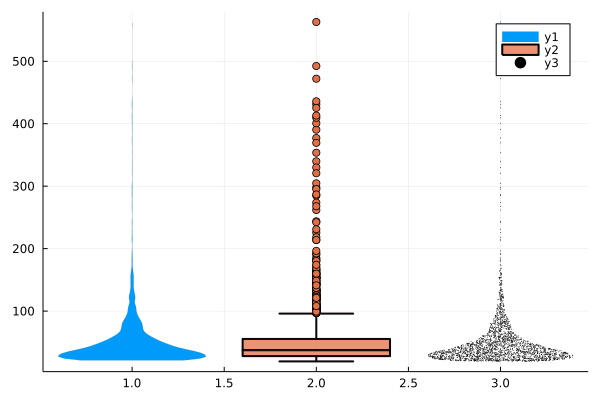

In [63]:
timings_with_saving_async = extract_frame_confirmation_timings("2_camera_2LS_with_stage_waiting_saving_async_Bitmap_2022_09_20_16_52.log")
@df timings_with_saving_async violin(:time, linewidth=0)
@df timings_with_saving_async boxplot!(:time, fillalpha=0.75, linewidth=2)
@df timings_with_saving_async dotplot!(:time, marker=(:black, stroke(0)), markersize = 0.5)

In [64]:
describe(timings_with_saving_async, :all, cols=:time)

,variable,mean,std,min,q25,median,q75,max,nunique
,Symbol,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Int64
1,time,50.3744,44.1922,19.4,27.9,37.5,55.4,562.9,868


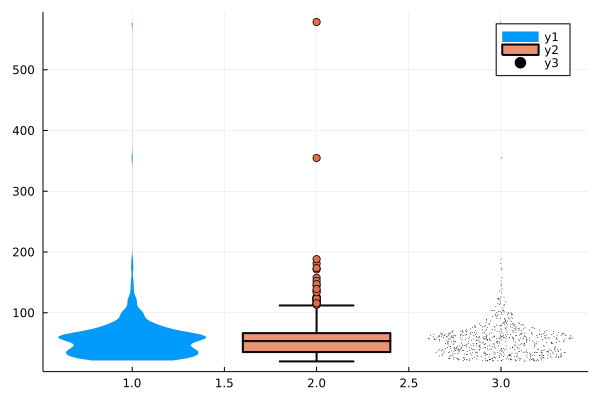

In [65]:
timings_with_saving_async = extract_frame_confirmation_timings("2_camera_2LS_with_stage_waiting_saving_async_Bitmap_2022_09_21_14_40.log")
@df timings_with_saving_async violin(:time, linewidth=0)
@df timings_with_saving_async boxplot!(:time, fillalpha=0.75, linewidth=2)
@df timings_with_saving_async dotplot!(:time, marker=(:black, stroke(0)), markersize = 0.5)

same but the filename contains GUID:
(The error with GDI+ is gone, and all files were saved.) RGB24 1920x1200 image format.

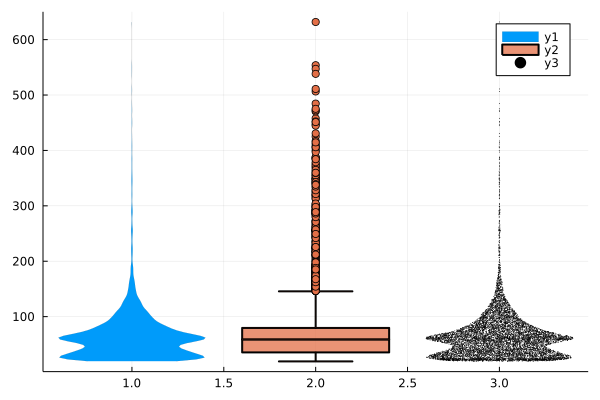

In [66]:
timings_with_saving_async = extract_frame_confirmation_timings(
    "2_camera_2LS_with_stage_waiting_saving_async_Bitmap_GUID_2022_09_21_19_04.log")
@df timings_with_saving_async violin(:time, linewidth=0)
@df timings_with_saving_async boxplot!(:time, fillalpha=0.75, linewidth=2)
@df timings_with_saving_async dotplot!(:time, marker=(:black, stroke(0)), markersize = 0.5)

In [67]:
describe(timings_with_saving_async, :all, cols=:time)

,variable,mean,std,min,q25,median,q75,max,nunique
,Symbol,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Int64
1,time,66.0699,47.4521,19.1,35.4,58.9,79.6,631.8,1848


Saving synchronously inside the event handler for incoming frame.
RGB24 1920x1200 image format. Using custom save to Bitmap:
(Does not lose any images, does not generate exceptions)

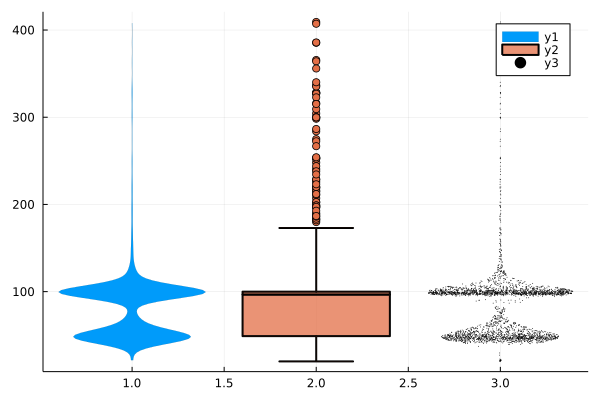

In [68]:
timings_with_saving_sync = extract_frame_confirmation_timings(
    "2_camera_2LS_with_stage_waiting_saving_inSync_Bitmap_2022_09_21_18_18.log")
@df timings_with_saving_sync violin(:time, linewidth=0)
@df timings_with_saving_sync boxplot!(:time, fillalpha=0.75, linewidth=2)
@df timings_with_saving_sync dotplot!(:time, marker=(:black, stroke(0)), markersize = 0.5)

In [69]:
describe(timings_with_saving_sync, :all, cols=:time)

,variable,mean,std,min,q25,median,q75,max,nunique
,Symbol,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Int64
1,time,82.2357,39.4639,20.0,49.0,96.7,100.0,409.2,756


Building in Release mode.
Saving async with custom Bitmap saver. RGB24 

launching a task has not exceeded 25ms.

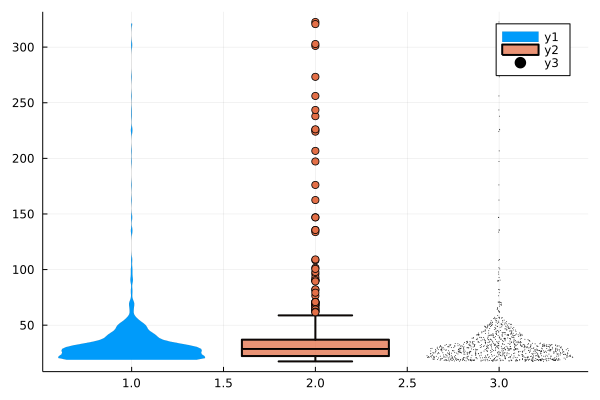

In [72]:
timings_with_saving_release = extract_frame_confirmation_timings(
    "2_camera_2LS_with_stage_waiting_saving_async_Bitmap_RELEASE_2022_09_21_20_40.log")
@df timings_with_saving_release violin(:time, linewidth=0)
@df timings_with_saving_release boxplot!(:time, fillalpha=0.75, linewidth=2)
@df timings_with_saving_release dotplot!(:time, marker=(:black, stroke(0)), markersize = 0.5)

In [73]:
describe(timings_with_saving_release, :all, cols=:time)

,variable,mean,std,min,q25,median,q75,max,nunique
,Symbol,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Int64
1,time,35.0532,30.5844,17.4,22.2,28.55,36.975,322.6,399


Building in Release mode.
Saving async with TIS Tiff saver. Y16 . Recording with Console (only ~8k lines copying manually at a time)

46 image saving threads were finishing only after the 60sec aquisition, this means that we can ran out of buffers very easily.
But with longer timelapse the Console had 2300 messages about finished image saving at the end. However all of the images were saved, so it appears that the buffers are not being depleted.

launching a task has not exceeded 25ms.
It does save all of the images.

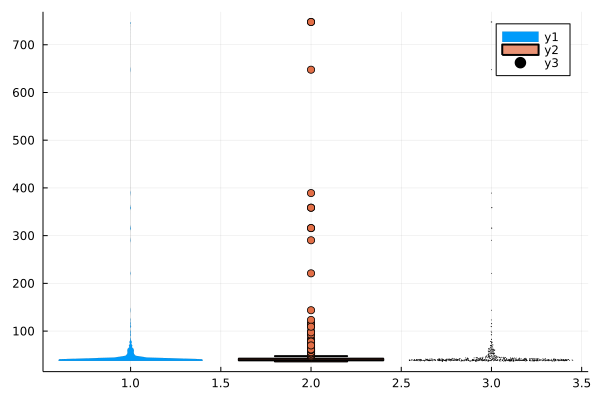

In [74]:
timings_with_saving_release = extract_frame_confirmation_timings(
    "2_camera_2LS_with_stage_waiting_saving_async_Tif_RELEASE_2022_09_21_21_27.log")
@df timings_with_saving_release violin(:time, linewidth=0)
@df timings_with_saving_release boxplot!(:time, fillalpha=0.75, linewidth=2)
@df timings_with_saving_release dotplot!(:time, marker=(:black, stroke(0)), markersize = 0.5)

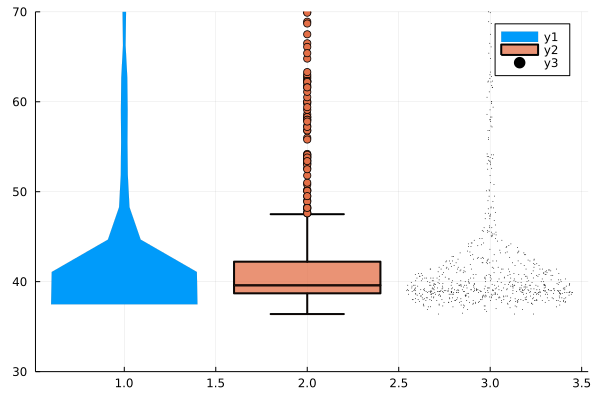

In [81]:
@df timings_with_saving_release violin(:time, linewidth=0, ylim=[30,70])
@df timings_with_saving_release boxplot!(:time, fillalpha=0.75, linewidth=2, ylim=[30,70])
@df timings_with_saving_release dotplot!(:time, marker=(:black, stroke(0)), markersize = 0.5, ylim=[30,70])

In [78]:
describe(timings_with_saving_release, :all, cols=:time)

,variable,mean,std,min,q25,median,q75,max,nunique
,Symbol,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Int64
1,time,48.3715,51.5411,36.4,38.7,39.6,42.225,747.7,200


Y16 1920x1200 

Saving to the SSD 

Separate confirmations for each camera

exposure = 1/19 sec

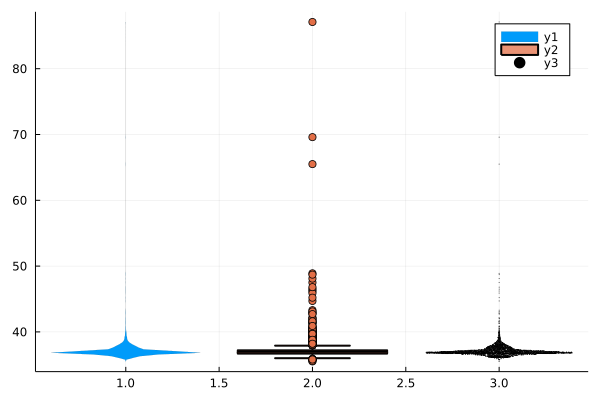

In [14]:
timings_with_saving_release = extract_frame_confirmation_timings(
    "2_camera_2LS_saving_async_Release_separate_confirm_SSD_2022_29_15_34.log")
@df timings_with_saving_release violin(:time, linewidth=0)
@df timings_with_saving_release boxplot!(:time, fillalpha=0.75, linewidth=2)
@df timings_with_saving_release dotplot!(:time, marker=(:black, stroke(0)), markersize = 0.5)

In [15]:
describe(timings_with_saving_release, :all, cols=:time)

,variable,mean,std,min,q25,median,q75,max,nunique
,Symbol,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Int64
1,time,37.11,1.30156,35.51,36.7,36.9,37.2,87.1,123


Y16 1920x1200 

Saving to the SSD 

Separate confirmations for each camera

exposure = 1/201 sec

Imaging as fast as possible.

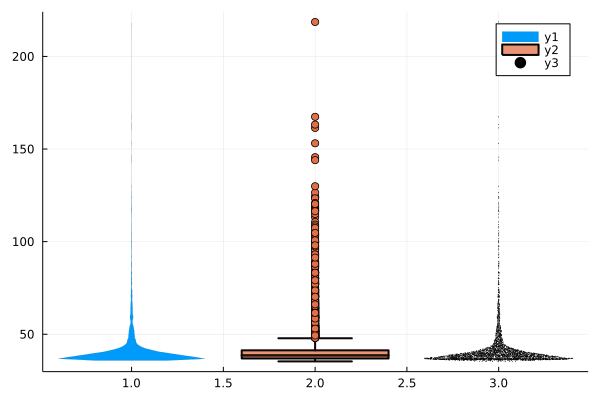

In [16]:
timings_with_saving_release = extract_frame_confirmation_timings(
    "2_camera_2LS_saving_async_Release_separate_confirm_SSD_5ms_exp_2022_29_16_47.log")
@df timings_with_saving_release violin(:time, linewidth=0)
@df timings_with_saving_release boxplot!(:time, fillalpha=0.75, linewidth=2)
@df timings_with_saving_release dotplot!(:time, marker=(:black, stroke(0)), markersize = 0.5)

In [17]:
describe(timings_with_saving_release, :all, cols=:time)

,variable,mean,std,min,q25,median,q75,max,nunique
,Symbol,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Int64
1,time,42.0982,12.0578,35.3,36.9,38.6,41.31,218.61,517


Y16 1920x1200 

Saving to the SSD 

Separate confirmations for each camera

exposure = 1/201 sec

Imaging at 30 min intervals.

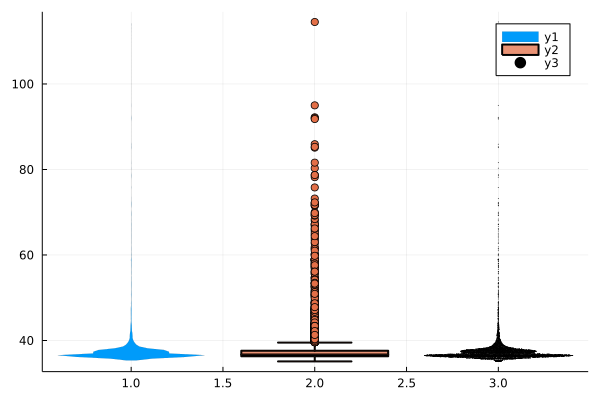

In [6]:
timings_with_saving_release = extract_frame_confirmation_timings(
    "2_cam_2LS_saving_async_Release_sep_conf_SSD_5ms_30min_intervals_2022_09_30_8_37.log")
@df timings_with_saving_release violin(:time, linewidth=0)
@df timings_with_saving_release boxplot!(:time, fillalpha=0.75, linewidth=2)
@df timings_with_saving_release dotplot!(:time, marker=(:black, stroke(0)), markersize = 0.5)

In [7]:
describe(timings_with_saving_release, :all, cols=:time)

,variable,mean,std,min,q25,median,q75,max,nunique
,Symbol,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Int64
1,time,37.479,3.42575,35.1,36.31,36.7,37.6,114.5,325
